In [27]:
import pandas as pd
from ydata_profiling import ProfileReport

# Load the data
df1 = pd.read_csv('covid_19_clean_complete.csv')
print(df1.head())

  Province/State Country/Region       Lat       Long        Date  Confirmed  \
0            NaN    Afghanistan  33.93911  67.709953  2020-01-22          0   
1            NaN        Albania  41.15330  20.168300  2020-01-22          0   
2            NaN        Algeria  28.03390   1.659600  2020-01-22          0   
3            NaN        Andorra  42.50630   1.521800  2020-01-22          0   
4            NaN         Angola -11.20270  17.873900  2020-01-22          0   

   Deaths  Recovered  Active             WHO Region  
0       0          0       0  Eastern Mediterranean  
1       0          0       0                 Europe  
2       0          0       0                 Africa  
3       0          0       0                 Europe  
4       0          0       0                 Africa  


In [28]:
# Load the economy data
df2 = pd.read_csv('economy_data.csv')
print(df2.head())

  Country_Code Country_Name        Date  Human_Development_Index  Total_Cases  \
0          AFG  Afghanistan  2019-12-31                    0.498          0.0   
1          AFG  Afghanistan  2020-01-01                    0.498          0.0   
2          AFG  Afghanistan  2020-01-02                    0.498          0.0   
3          AFG  Afghanistan  2020-01-03                    0.498          0.0   
4          AFG  Afghanistan  2020-01-04                    0.498          0.0   

   Total_Deaths  Stringency_Index  Population  GDP_Per_Capita  
0           0.0               0.0   17.477233        7.497754  
1           0.0               0.0   17.477233        7.497754  
2           0.0               0.0   17.477233        7.497754  
3           0.0               0.0   17.477233        7.497754  
4           0.0               0.0   17.477233        7.497754  


In [5]:
profile1 = ProfileReport(df1)
profile1

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
profile2 = ProfileReport(df2)
profile2

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [29]:
# Convertir las columnas de fecha a datetime
df1['Date'] = pd.to_datetime(df1['Date'])
df2['Date'] = pd.to_datetime(df2['Date'])

# Redondear las fechas al intervalo de 5 días más cercano
df1['Date'] = df1['Date'].dt.round('5D')
df2['Date'] = df2['Date'].dt.round('5D')
# Limitar los dataframes a los primeros 1000 registros


# Renombrar la columna 'Country_Name' en df2_limited a 'Country/Region'
df2 = df2.rename(columns={'Country_Name': 'Country/Region'})

# Ahora puedes hacer el merge
df_joined = df1.merge(df2, on=['Date', 'Country/Region'], suffixes=('_df1', '_df2'))

# Eliminar registros duplicados
df_joined = df_joined.drop_duplicates()

df_joined = df_joined.dropna(subset=['Human_Development_Index'])

print(df_joined.tail())



       Province/State Country/Region    Lat     Long       Date  Confirmed  \
203558            NaN        Lesotho -29.61  28.2336 2020-07-27        419   
203560            NaN        Lesotho -29.61  28.2336 2020-07-27        505   
203561            NaN        Lesotho -29.61  28.2336 2020-07-27        505   
203562            NaN        Lesotho -29.61  28.2336 2020-07-27        505   
203563            NaN        Lesotho -29.61  28.2336 2020-07-27        505   

        Deaths  Recovered  Active WHO Region Country_Code  \
203558       9         69     341     Africa          LSO   
203560      12        128     365     Africa          LSO   
203561      12        128     365     Africa          LSO   
203562      12        128     365     Africa          LSO   
203563      12        128     365     Africa          LSO   

        Human_Development_Index  Total_Cases  Total_Deaths  Stringency_Index  \
203558                     0.52     6.224558      2.484907          4.266896   
2035

In [9]:
profileTotal = ProfileReport(df_joined)
profileTotal

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## **Anáisis Exploratorio**

### Descripción de variables

1.  **Province/State** (Cualitativa nominal): Información sobre la provincia o estado.
2.  **Country/Region** (Cualitativa nominal): El país o región.
3.  **Lat** (Cuantitativa continua): Latitud geográfica.
4.  **Long** (Cuantitativa continua): Longitud geográfica.
5.  **Date** (Cualitativa ordinal): Fecha de la observación, puede ser considerada ordinal en el contexto de series temporales.
6.  **Confirmed** (Cuantitativa discreta): Número de casos confirmados.
7.  **Deaths** (Cuantitativa discreta): Número de muertes.
8.  **Recovered** (Cuantitativa discreta): Número de recuperados.
9.  **Active** (Cuantitativa discreta): Número de casos activos.
10.  **WHO Region** (Cualitativa nominal): Región de la OMS.
11.  **Country_Code** (Cualitativa nominal): Código de país.
12.  **Human_Development_Index** (Cuantitativa continua): Índice de Desarrollo Humano.
13.  **Total_Cases** (Cuantitativa discreta): Total de casos, aunque se contabiliza podría ser considerada continua debido a la gran escala de valores.
14.  **Total_Deaths** (Cuantitativa discreta): Total de muertes, similarmente podría ser considerada continua en grandes escalas.
15.  **Stringency_Index** (Cuantitativa continua): Índice de Estrictitud.
16.  **Population** (Cuantitativa continua): Población.
17.  **GDP_Per_Capita** (Cuantitativa continua): PIB per cápita

In [30]:
resumen_numerico = df_joined.describe()
print("Resumen de variables numéricas:")
print(resumen_numerico)

Resumen de variables numéricas:
                 Lat           Long                           Date  \
count  123305.000000  123305.000000                         123305   
mean       23.983254      27.327281  2020-05-10 05:08:36.037468160   
min       -51.796300    -135.000000            2020-01-24 00:00:00   
25%         9.145000      -7.092600            2020-04-03 00:00:00   
50%        28.166700      24.966800            2020-05-13 00:00:00   
75%        42.733900      84.250000            2020-06-17 00:00:00   
max        64.963100     178.065000            2020-07-27 00:00:00   
std        25.002580      69.073461                            NaN   

          Confirmed         Deaths     Recovered         Active  \
count  1.233050e+05  123305.000000  1.233050e+05  123305.000000   
mean   2.361534e+04    1259.617655  1.292791e+04    9427.807615   
min    0.000000e+00       0.000000  0.000000e+00     -14.000000   
25%    1.830000e+02       2.000000  1.500000e+01      48.000000   
50

In [31]:
from scipy.stats import normaltest
import numpy as np

# Prueba de normalidad para las variables numéricas
print("\nPrueba de normalidad:")
for column in df_joined.select_dtypes(include=[np.number]).columns:
    stat, p = normaltest(df_joined[column].dropna())
    print(f"{column}:")
    print(f"  Estadístico = {stat}, p-valor = {p}")
    if p > 0.05:
        print("  Distribución normal")
    else:
        print("  Distribución no normal")


Prueba de normalidad:
Lat:
  Estadístico = 9987.194045137101, p-valor = 0.0
  Distribución no normal
Long:
  Estadístico = 8416.089140435244, p-valor = 0.0
  Distribución no normal
Confirmed:
  Estadístico = 212819.7482669746, p-valor = 0.0
  Distribución no normal
Deaths:
  Estadístico = 156856.91499244655, p-valor = 0.0
  Distribución no normal
Recovered:
  Estadístico = 227459.77127840143, p-valor = 0.0
  Distribución no normal
Active:
  Estadístico = 173816.33675585035, p-valor = 0.0
  Distribución no normal
Human_Development_Index:
  Estadístico = 23673.3759613801, p-valor = 0.0
  Distribución no normal
Total_Cases:
  Estadístico = 7366.241339933401, p-valor = 0.0
  Distribución no normal
Total_Deaths:
  Estadístico = 48570.08335591895, p-valor = 0.0
  Distribución no normal
Stringency_Index:
  Estadístico = 85787.28935780737, p-valor = 0.0
  Distribución no normal
Population:
  Estadístico = 1097.6906796248047, p-valor = 4.3601105527487675e-239
  Distribución no normal
GDP_Per_C

In [32]:
# Tablas de frecuencia para las variables categóricas
print("\nTablas de frecuencia para variables categóricas:")
for column in df_joined.select_dtypes(include=['object']).columns:
    print(f"\nFrecuencia de {column}:")
    print(df_joined[column].value_counts())


Tablas de frecuencia para variables categóricas:

Frecuencia de Province/State:
Province/State
Hong Kong                    875
Shanghai                     848
Guangdong                    834
Beijing                      810
Ontario                      764
                            ... 
Tibet                        198
Saint Barthelemy             193
Anguilla                     189
Northwest Territories        176
Saint Pierre and Miquelon    172
Name: count, Length: 77, dtype: int64

Frecuencia de Country/Region:
Country/Region
China                    17004
Canada                    5714
France                    4319
Australia                 4234
United Kingdom            4218
                         ...  
Seychelles                  78
Saint Lucia                 68
Dominica                    65
Saint Kitts and Nevis       61
Grenada                     60
Name: count, Length: 170, dtype: int64

Frecuencia de WHO Region:
WHO Region
Europe                   41197
Western 

## Despliegue de Gráficos de Variables

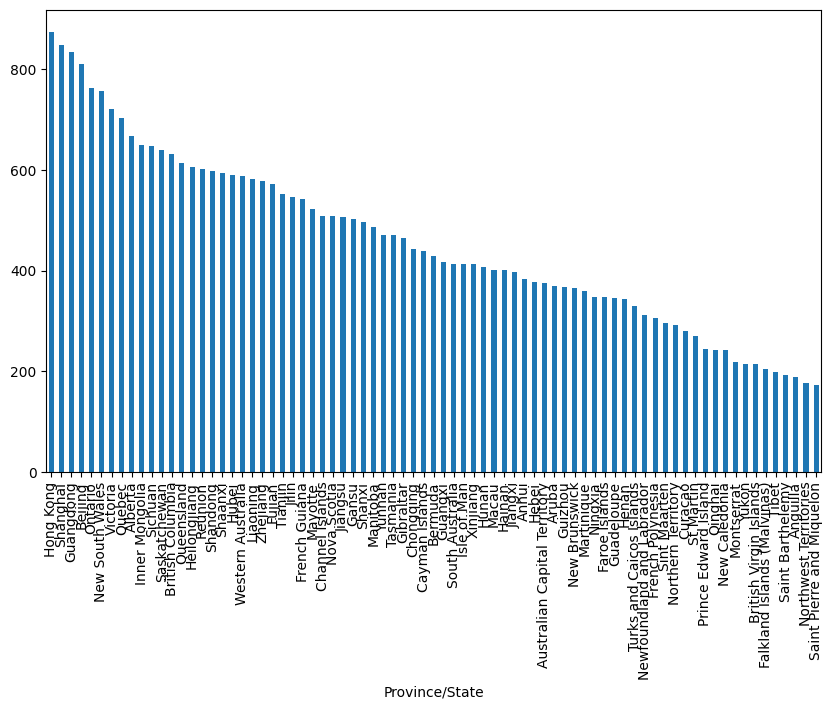

In [33]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
df_joined['Province/State'].value_counts().plot(kind='bar')
plt.show()

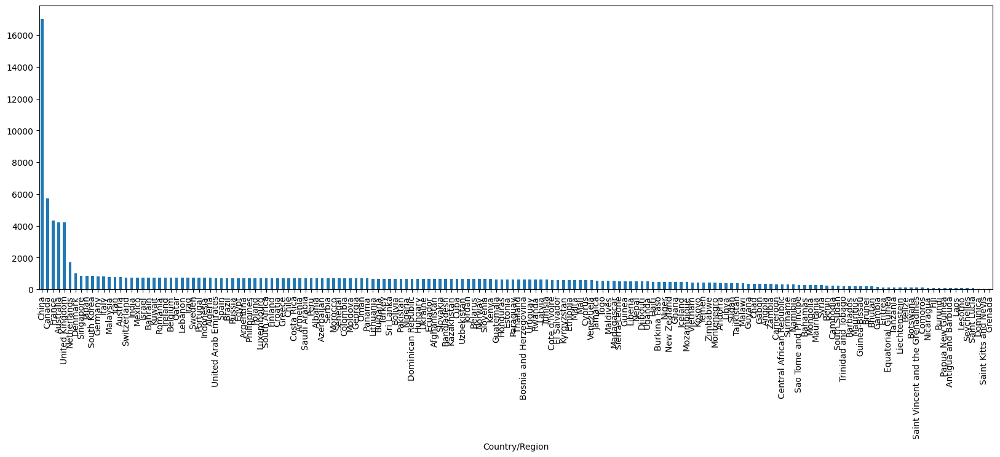

In [34]:
plt.figure(figsize=(20, 6))
df_joined['Country/Region'].value_counts().plot(kind='bar')
plt.show()

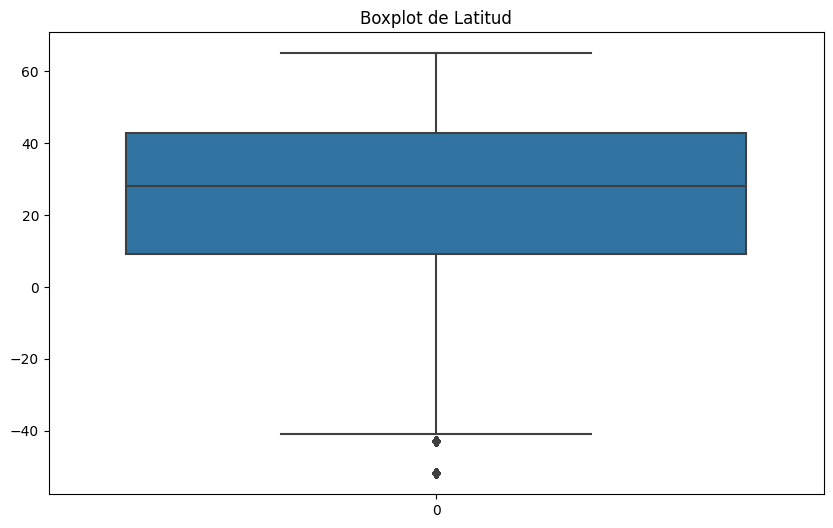

In [35]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Lat'])
plt.title('Boxplot de Latitud')
plt.show()

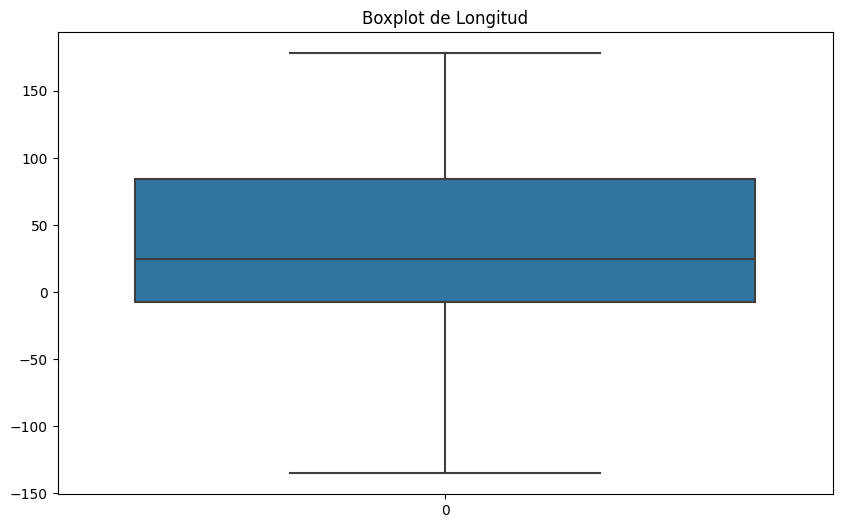

In [36]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Long'])
plt.title('Boxplot de Longitud')
plt.show()

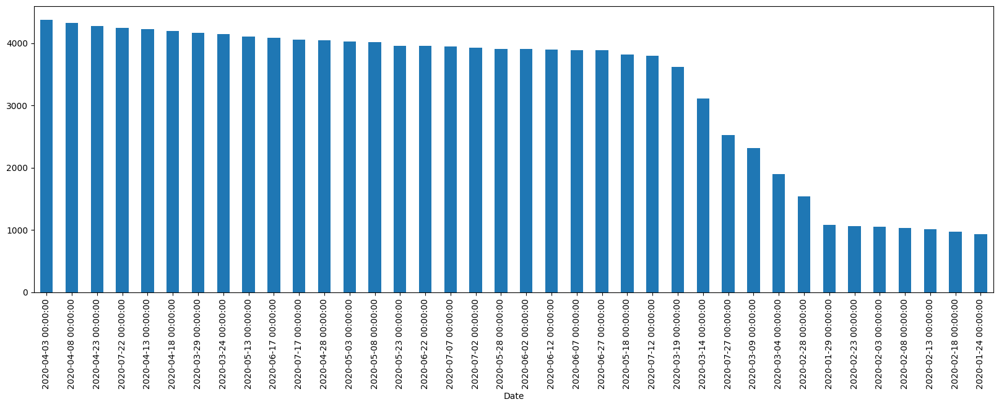

In [37]:
plt.figure(figsize=(20, 6))
df_joined['Date'].value_counts().plot(kind='bar')
plt.show()

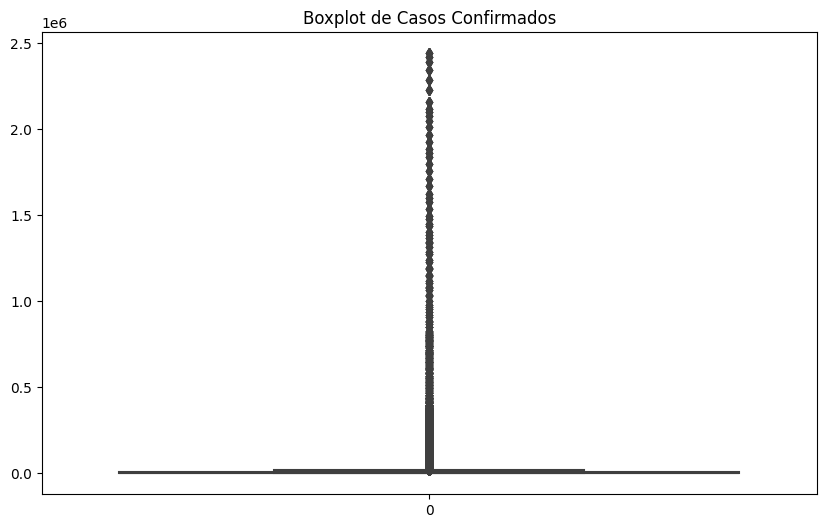

In [38]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Confirmed'])
plt.title('Boxplot de Casos Confirmados')
plt.show()

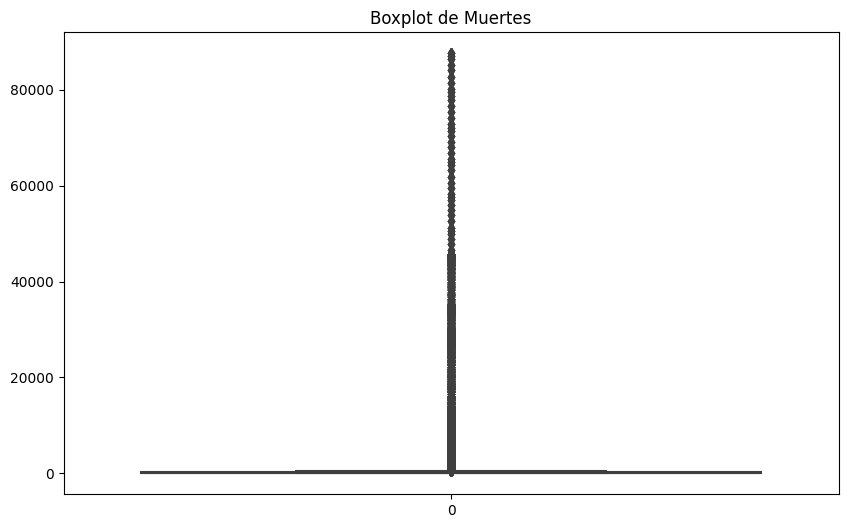

In [39]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Deaths'])
plt.title('Boxplot de Muertes')
plt.show()

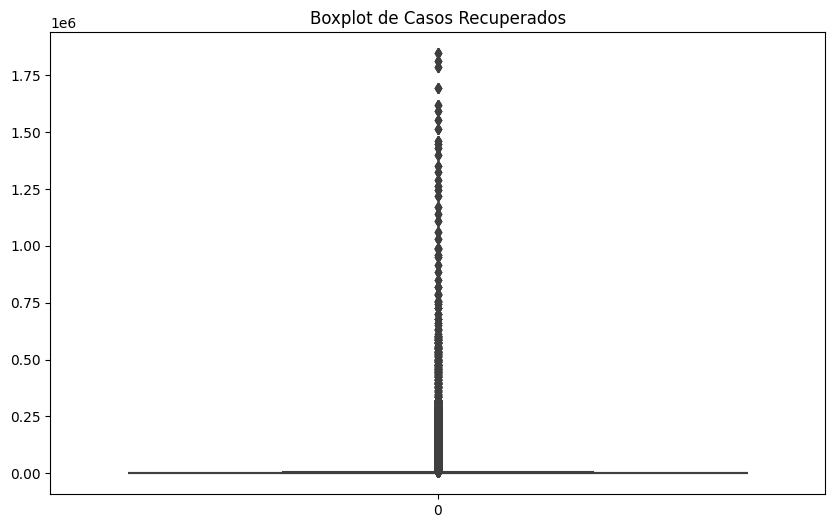

In [40]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Recovered'])
plt.title('Boxplot de Casos Recuperados')
plt.show()

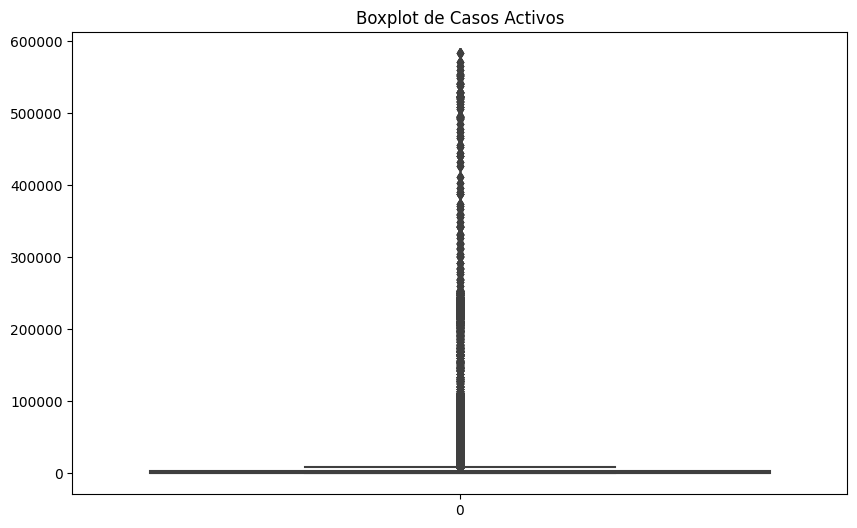

In [42]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Active'])
plt.title('Boxplot de Casos Activos')
plt.show()

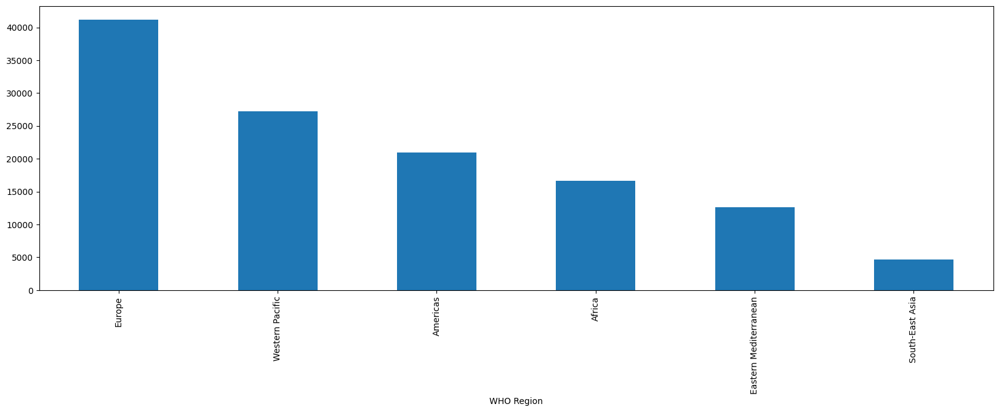

In [44]:
plt.figure(figsize=(20, 6))
df_joined['WHO Region'].value_counts().plot(kind='bar')
plt.show()

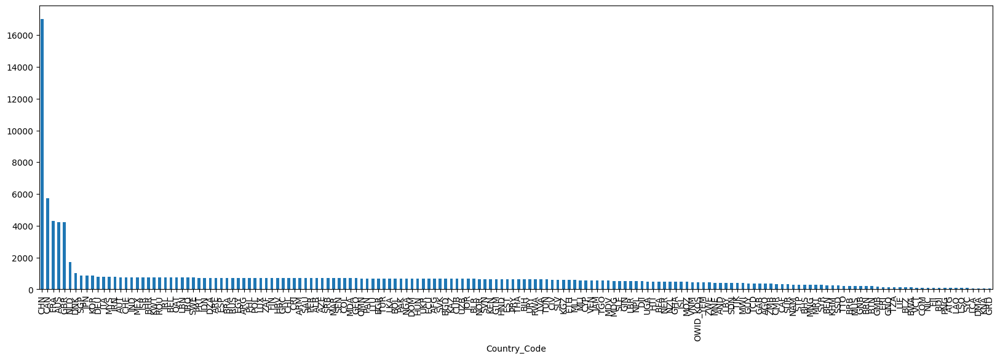

In [46]:
plt.figure(figsize=(20, 6))
df_joined['Country_Code'].value_counts().plot(kind='bar')
plt.show()

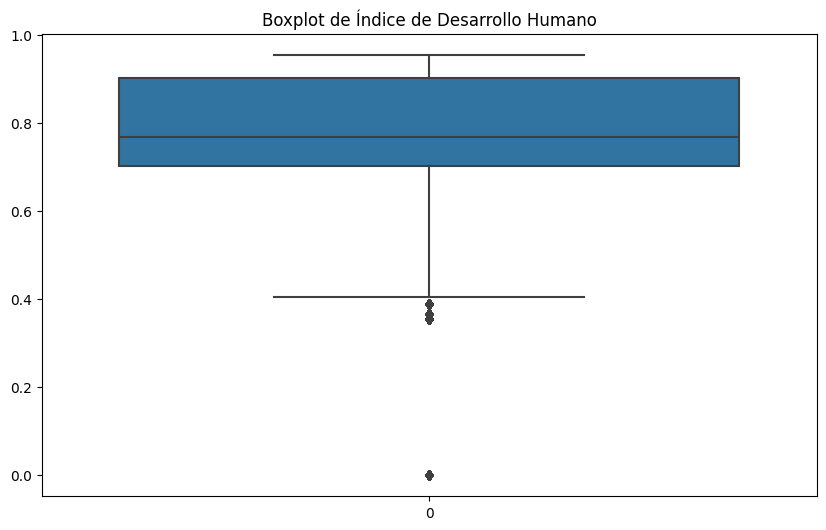

In [48]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Human_Development_Index'])
plt.title('Boxplot de Índice de Desarrollo Humano')
plt.show()

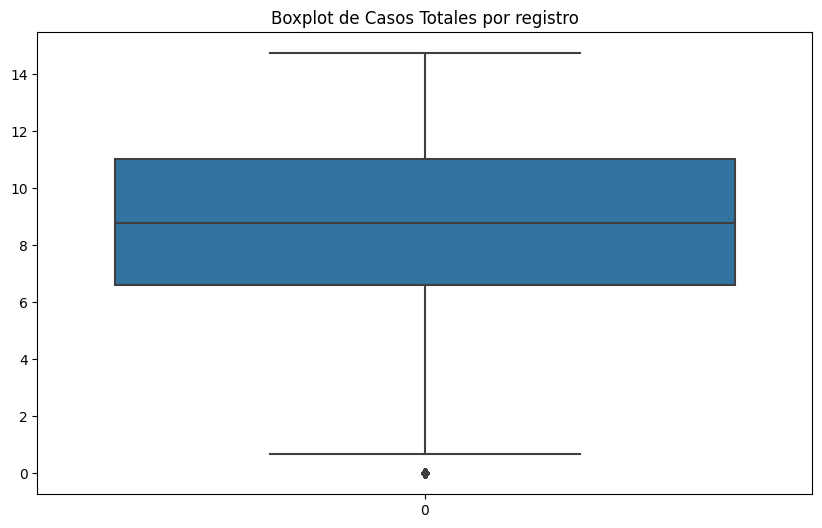

In [50]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Total_Cases'])
plt.title('Boxplot de Casos Totales por registro')
plt.show()

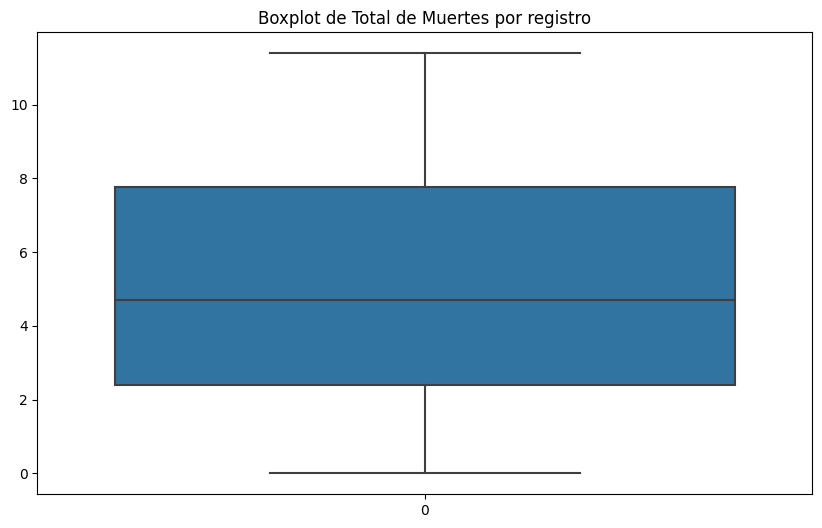

In [51]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Total_Deaths'])
plt.title('Boxplot de Total de Muertes por registro')
plt.show()

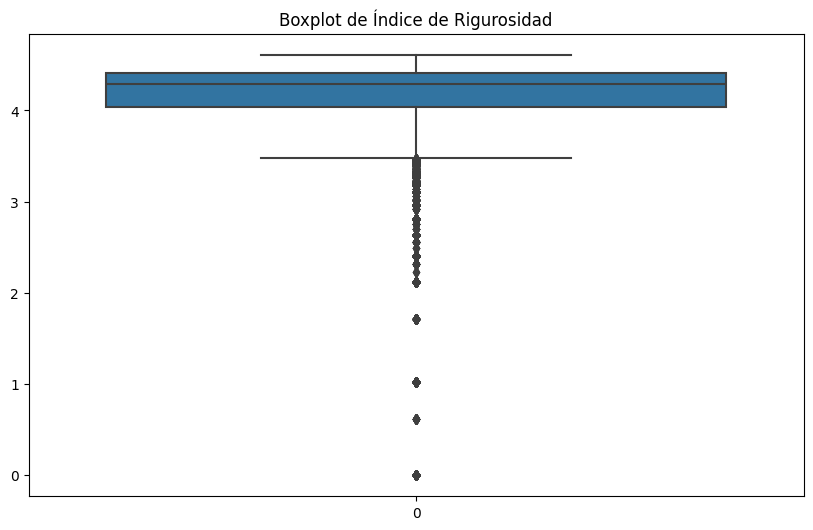

In [52]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Stringency_Index'])
plt.title('Boxplot de Índice de Rigurosidad')
plt.show()

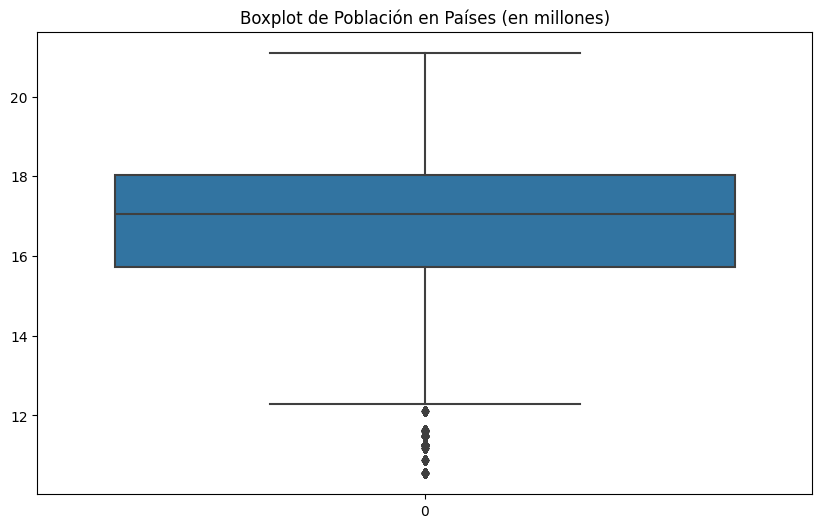

In [54]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['Population'])
plt.title('Boxplot de Población en Países (en millones)')
plt.show()

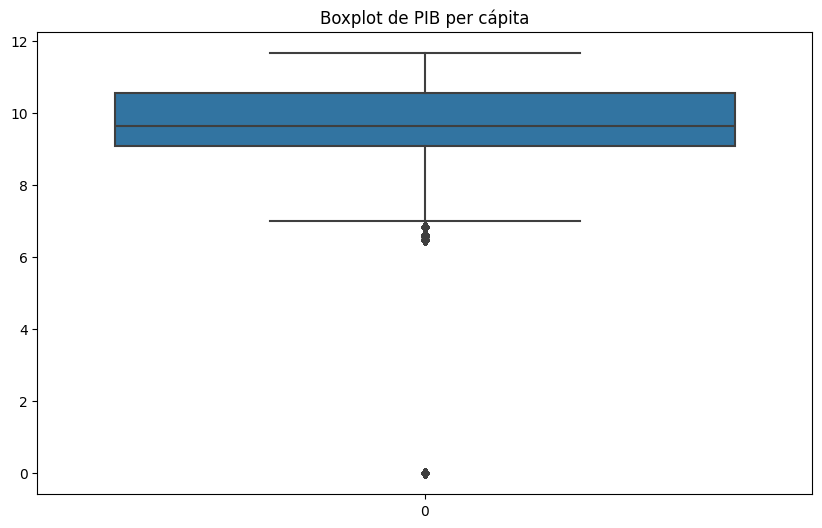

In [55]:
import seaborn as sns
plt.figure(figsize=(10, 6))
sns.boxplot(df_joined['GDP_Per_Capita'])
plt.title('Boxplot de PIB per cápita')
plt.show()

### Elección de Variables para el Análisis


1.  **Confirmed Cases (Casos confirmados)**: Esta variable es fundamental para entender la severidad y la expansión de la pandemia en diferentes regiones y países.
2.  **GDP_Per_Capita (PIB per cápita)**: Indicador económico clave para mostrar cómo las variaciones en la economía de un país están relacionadas con la pandemia.
3.  **Human_Development_Index (Índice de Desarrollo Humano - IDH)**: Este índice combina indicadores de salud, educación y nivel de vida, proporcionando una medida compuesta que puede correlacionarse con la resiliencia de un país frente a la pandemia.
4.  **Total_Deaths (Total de muertes)**: Para evaluar el impacto directo en términos de mortalidad por COVID-19.

Estas variables permiten explorar tanto el impacto directo de la pandemia (a través de casos confirmados y muertes) como las posibles consecuencias económicas y sociales (mediante el PIB per cápita y el IDH). Al cruzar estos datos, podríamos descubrir patrones o correlaciones que sugieran cómo la severidad de la pandemia afecta a diferentes aspectos de un país, o viceversa, cómo ciertas condiciones preexistentes en un país pueden influir en su capacidad para manejar la pandemia.

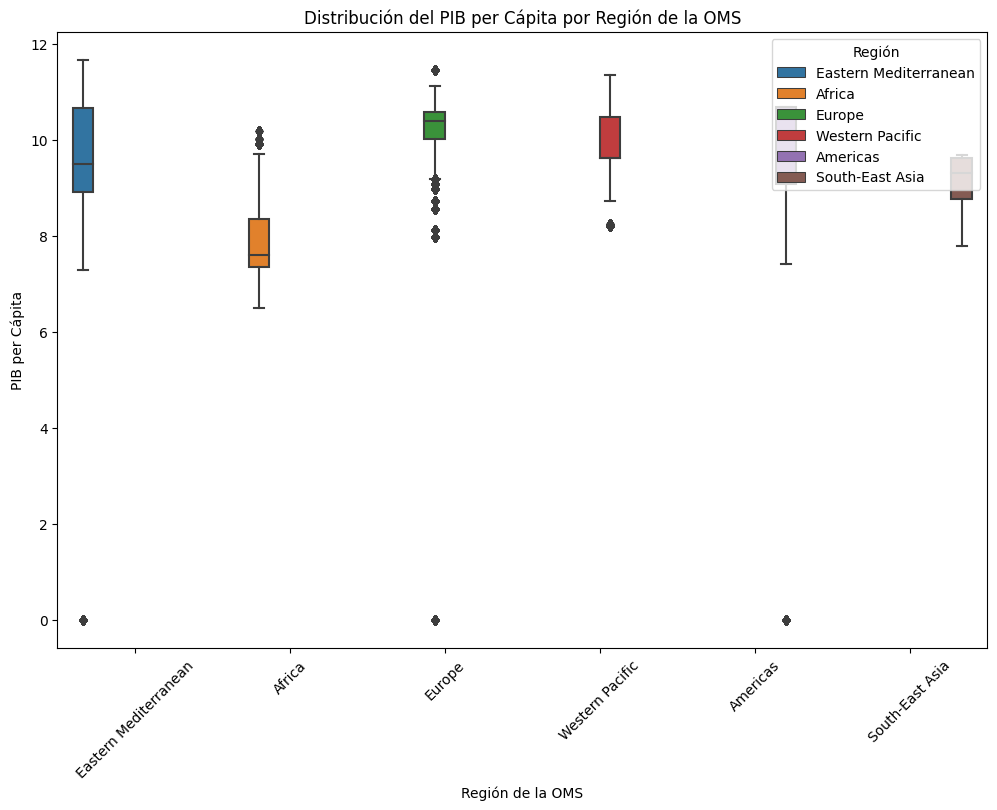

In [24]:
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

plt.figure(figsize=(12, 8)) 
sns.boxplot(data=df_joined, x='WHO Region', y='GDP_Per_Capita', hue='WHO Region')
plt.title('Distribución del PIB per Cápita por Región de la OMS')
plt.xlabel('Región de la OMS')
plt.ylabel('PIB per Cápita')
plt.xticks(rotation=45)
plt.legend(title='Región', loc='upper right') 
plt.show()


In [39]:
# Eliminar filas donde las variables críticas tienen valores faltantes
df_joined.dropna(subset=['Confirmed', 'Deaths', 'Recovered', 'GDP_Per_Capita', 'Human_Development_Index'], inplace=True)


from sklearn.preprocessing import StandardScaler

# Seleccionar solo las variables numéricas para la normalización
variables_numericas = df_joined[['Confirmed', 'Deaths', 'Recovered', 'GDP_Per_Capita', 'Human_Development_Index']]
scaler = StandardScaler()
variables_normalizadas = scaler.fit_transform(variables_numericas)

# Reemplazar las columnas originales en el DataFrame por las normalizadas
df_joined[['Confirmed', 'Deaths', 'Recovered', 'GDP_Per_Capita', 'Human_Development_Index']] = variables_normalizadas


# Codifica variables categóricas
df_encoded = pd.get_dummies(df_joined, columns=['Province/State', 'Country/Region', 'WHO Region'])




In [40]:
df_encoded

,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,Country_Code,Human_Development_Index,Total_Cases,...,Country/Region_Vietnam,Country/Region_Yemen,Country/Region_Zambia,Country/Region_Zimbabwe,WHO Region_Africa,WHO Region_Americas,WHO Region_Eastern Mediterranean,WHO Region_Europe,WHO Region_South-East Asia,WHO Region_Western Pacific
0,33.93911,67.709953,2020-01-24,-0.239786,-0.232503,-0.201208,0,AFG,-1.790713,0.000000,...,0,0,0,0,0,0,1,0,0,0
25,28.03390,1.659600,2020-01-24,-0.239786,-0.232503,-0.201208,0,DZA,-0.072970,0.000000,...,0,0,0,0,1,0,0,0,0,0
50,40.06910,45.038200,2020-01-24,-0.239786,-0.232503,-0.201208,0,ARM,-0.066260,0.000000,...,0,0,0,0,0,0,0,1,0,0
75,-35.47350,149.012400,2020-01-24,-0.239786,-0.232503,-0.201208,0,AUS,1.168368,0.000000,...,0,0,0,0,0,0,0,0,0,1
78,-35.47350,149.012400,2020-01-24,-0.239786,-0.232503,-0.201208,0,AUS,1.168368,0.000000,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203558,-29.61000,28.233600,2020-07-27,-0.235532,-0.230842,-0.200134,341,LSO,-1.643095,6.224558,...,0,0,0,0,1,0,0,0,0,0
203560,-29.61000,28.233600,2020-07-27,-0.234658,-0.230288,-0.199216,365,LSO,-1.643095,5.883322,...,0,0,0,0,1,0,0,0,0,0
203561,-29.61000,28.233600,2020-07-27,-0.234658,-0.230288,-0.199216,365,LSO,-1.643095,6.037871,...,0,0,0,0,1,0,0,0,0,0
203562,-29.61000,28.233600,2020-07-27,-0.234658,-0.230288,-0.199216,365,LSO,-1.643095,6.100319,...,0,0,0,0,1,0,0,0,0,0


### Custering

c:\Users\brand\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


c:\Users\brand\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\brand\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\brand\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\brand\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\clus

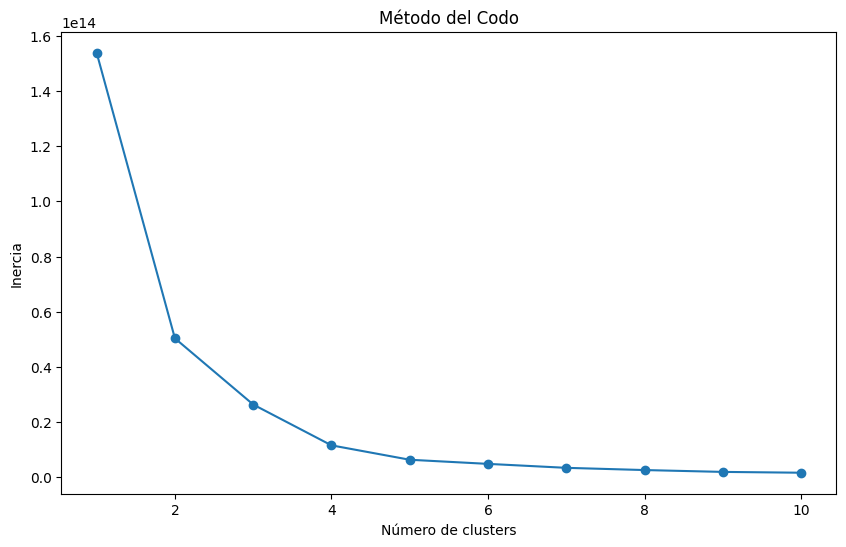

In [54]:
from sklearn.cluster import KMeans

columnas_interes = ['Confirmed', 'Deaths', 'Recovered', 'Active', 'Human_Development_Index',  'GDP_Per_Capita','Total_Cases', 'Total_Deaths']
df_reducido = df_encoded[columnas_interes]

inertias = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_reducido)
    inertias.append(kmeans.inertia_)

# Visualizar el método del codo
plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), inertias, marker='o')
plt.title('Método del Codo')
plt.xlabel('Número de clusters')
plt.ylabel('Inercia')
plt.show()

In [55]:
n_clusters_optimo = 3 
kmeans = KMeans(n_clusters=n_clusters_optimo, random_state=42)
kmeans.fit(df_reducido)

df_reducido['Cluster'] = kmeans.labels_

c:\Users\brand\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\brand\AppData\Local\Temp\ipykernel_18504\2490740754.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_reducido['Cluster'] = kmeans.labels_


In [56]:
# Contar el número de observaciones en cada cluster
distribucion_clusters = df_reducido['Cluster'].value_counts()
print("Distribución de los Clusters:")
print(distribucion_clusters)


Distribución de los Clusters:
0    116222
2      5803
1      1280
Name: Cluster, dtype: int64


In [57]:
# Análisis descriptivo para cada cluster
for i in range(n_clusters_optimo):  # Asumiendo n_clusters_optimo es el número de clusters que elegiste
    cluster_data = df_reducido[df_reducido['Cluster'] == i]
    print(f"\nCluster {i}:")
    print(cluster_data[columnas_interes].describe())



Cluster 0:
           Confirmed         Deaths      Recovered         Active  \
count  116222.000000  116222.000000  116222.000000  116222.000000   
mean       -0.138766      -0.146418      -0.103374    3196.638941   
std         0.309020       0.431693       0.387292    6838.562276   
min        -0.239786      -0.232503      -0.201208     -14.000000   
25%        -0.238121      -0.232319      -0.200990      41.000000   
50%        -0.230394      -0.230288      -0.196819     316.000000   
75%        -0.185067      -0.211646      -0.173209    2105.000000   
max         3.292964       6.945541       4.778502   37866.000000   

       Human_Development_Index  GDP_Per_Capita    Total_Cases   Total_Deaths  
count            116222.000000   116222.000000  116222.000000  116222.000000  
mean                 -0.019672       -0.017652       8.166877       4.611163  
std                   1.010482        1.019543       2.814829       3.022800  
min                  -5.132260       -6.385297    